In [444]:
import networkx as nx

threshold_graph = nx.read_graphml('../Graphs/pearson_correlation_threshold_graph.graphml')

In [445]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch_geometric.data import Data, DataLoader
from torch_geometric.nn import GCNConv

In [446]:
import pandas as pd

df = pd.read_csv('D:\MANU\Datasets\yfinance_weekly_data.csv')
df.set_index('Date', inplace=True)

df.head()

,Adj Close,symbol
Date,,
2013-01-01,67.343964,MMM
2013-01-08,68.465317,MMM
2013-01-15,69.636024,MMM
2013-01-22,70.983017,MMM
2013-01-29,71.067688,MMM


2 Approaches:
1. Train the model to predict future price for every 26th week
 - add new column: 'future_price' -> data['future_price'] = data['Adj Close'].shift(-26)
 <!-- - add new column: 'price_change' that calculates the price change percatnage between the current and future price -> df['price_change'] = (df['future_price'] - df['Adj_Close']) / df['Adj_Close'] * 100 -->

 - the data needs to be split like: 
    X = data.drop('future_price', axis=1)
    Y = data['future_price']

2. Train the model to predict future price for every next week and when the model is trained itteratively predict every week price for all the 26 weeks. Meanwhile add the predicted price in the dataset for predicting the next week and so on, till we reach the target week.

In both approaches we then need to calculate the price change percentage between the target week and the current week.

In [447]:
# Preprocess the data
# Normalize the data

from sklearn.preprocessing import MinMaxScaler

adj_close_values = df['Adj Close'].values.reshape(-1, 1)
scaler = MinMaxScaler()
scaled_adj_close = scaler.fit_transform(adj_close_values)
df['Adj Close'] = scaled_adj_close
print(df.head())

            Adj Close symbol
Date                        
2013-01-01   0.011449    MMM
2013-01-08   0.011641    MMM
2013-01-15   0.011843    MMM
2013-01-22   0.012074    MMM
2013-01-29   0.012089    MMM


In [448]:
# Add future_price to the dataset

df['future_price'] = df.groupby('symbol')['Adj Close'].shift(-26)

df.head()

,Adj Close,symbol,future_price
Date,,,
2013-01-01,0.011449,MMM,0.013627
2013-01-08,0.011641,MMM,0.013961
2013-01-15,0.011843,MMM,0.014136
2013-01-22,0.012074,MMM,0.014177
2013-01-29,0.012089,MMM,0.014337


In [449]:
# Check for missing values and handle them

df.isna().sum()

Adj Close           0
symbol              0
future_price    12454
dtype: int64

In [450]:
df.dropna(axis=0, inplace=True)

In [451]:
df.isna().sum()

Adj Close       0
symbol          0
future_price    0
dtype: int64

In [452]:
# Add the data to the graph
for company in threshold_graph.nodes:
    company_data = df[df['symbol'] == company]
    adj_close_dict = dict(zip(company_data.index, company_data['Adj Close']))
    nx.set_node_attributes(threshold_graph, {company: adj_close_dict}, name='Adj Close')

    future_price_dict = dict(zip(company_data.index, company_data['future_price']))
    nx.set_node_attributes(threshold_graph, {company: future_price_dict}, name='Future Price')    

In [453]:
print("Nodes:")
for node_id, attributes in threshold_graph.nodes(data=True):
    print(f"Node {node_id}: {attributes}")
print("\nEdges:")
for edge in threshold_graph.edges(data=True):
    print(f"Edge {edge[:2]}: {edge[2]}")

Nodes:
Node A: {'Name': 'Agilent Technologies', 'Sector': 'Health Care', 'Adj Close': {'2013-01-01': 0.004639675427027099, '2013-01-08': 0.004750503452749321, '2013-01-15': 0.004818792524037526, '2013-01-22': 0.004934099058958561, '2013-01-29': 0.004831106785535522, '2013-02-05': 0.004869168869569467, '2013-02-12': 0.004606088574594486, '2013-02-19': 0.0044986204140506185, '2013-02-26': 0.004581460707117989, '2013-03-05': 0.00466878180370241, '2013-03-12': 0.004639675427027099, '2013-03-19': 0.004480708343813853, '2013-03-26': 0.004458317764378274, '2013-04-02': 0.004553375302058186, '2013-04-09': 0.004708306679492379, '2013-04-16': 0.00457470721750722, '2013-04-23': 0.004530920809471716, '2013-04-30': 0.004591545219049275, '2013-05-07': 0.004708306679492379, '2013-05-14': 0.005078791877379833, '2013-05-21': 0.0049945890870393755, '2013-05-28': 0.004985608142180132, '2013-06-04': 0.004898038603706609, '2013-06-11': 0.004858745781818334, '2013-06-18': 0.004626349043426794, '2013-06-25':

In [454]:
nodes = threshold_graph.nodes(data=True)
sortedlist = sorted([len(node[1]['Future Price']) for node in nodes])
print(sortedlist[:36])


[60, 120, 120, 163, 172, 173, 173, 187, 219, 269, 295, 296, 313, 328, 350, 365, 365, 367, 377, 392, 402, 406, 406, 414, 414, 422, 429, 447, 450, 471, 472, 472, 478, 492, 494, 495]


In [455]:
# Delete the nodes(edges) that does not have enough data

nodes_to_remove = [node for node in threshold_graph.nodes(data=True) if len(node[1].get('Future Price', [])) < 496]

edges_to_remove = []
for edge in threshold_graph.edges():
    if edge[0] in [node[0] for node in nodes_to_remove] or edge[1] in [node[0] for node in nodes_to_remove]:
        edges_to_remove.append(edge)

threshold_graph.remove_nodes_from([node[0] for node in nodes_to_remove])
threshold_graph.remove_edges_from(edges_to_remove)

In [456]:
print(len(threshold_graph.nodes))
print(len(threshold_graph.edges))

443
31665


In [457]:
# Delete the Name attribute from the nodes
for node in threshold_graph.nodes(data=True):
    del node[1]['Name']

In [458]:
from sklearn.preprocessing import LabelEncoder

encoder = LabelEncoder()

sectors = []
for node in threshold_graph.nodes(data=True):
    sector = node[1]['Sector']
    if sector not in sectors:
        sectors.append(sector)


sector_encoded = encoder.fit_transform(sectors)
sector_dict = dict(zip(sectors, sector_encoded))

for node in threshold_graph.nodes(data=True):
    node[1]['Sector'] = sector_dict[node[1]['Sector']]


In [459]:
print("Nodes:")
for node_id, attributes in threshold_graph.nodes(data=True):
    print(f"Node {node_id}: {attributes}")

Nodes:
Node A: {'Sector': 5, 'Adj Close': {'2013-01-01': 0.004639675427027099, '2013-01-08': 0.004750503452749321, '2013-01-15': 0.004818792524037526, '2013-01-22': 0.004934099058958561, '2013-01-29': 0.004831106785535522, '2013-02-05': 0.004869168869569467, '2013-02-12': 0.004606088574594486, '2013-02-19': 0.0044986204140506185, '2013-02-26': 0.004581460707117989, '2013-03-05': 0.00466878180370241, '2013-03-12': 0.004639675427027099, '2013-03-19': 0.004480708343813853, '2013-03-26': 0.004458317764378274, '2013-04-02': 0.004553375302058186, '2013-04-09': 0.004708306679492379, '2013-04-16': 0.00457470721750722, '2013-04-23': 0.004530920809471716, '2013-04-30': 0.004591545219049275, '2013-05-07': 0.004708306679492379, '2013-05-14': 0.005078791877379833, '2013-05-21': 0.0049945890870393755, '2013-05-28': 0.004985608142180132, '2013-06-04': 0.004898038603706609, '2013-06-11': 0.004858745781818334, '2013-06-18': 0.004626349043426794, '2013-06-25': 0.0047700530106878775, '2013-07-02': 0.0048

In [460]:
node_to_index = {label: index for index, label in enumerate(threshold_graph.nodes)}

In [461]:
mapped_node_index = torch.tensor([
    [node_to_index[node] for node in threshold_graph.nodes],
], dtype=torch.long).contiguous()

print(mapped_node_index)

tensor([[  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,
          14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,  27,
          28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,  40,  41,
          42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,  53,  54,  55,
          56,  57,  58,  59,  60,  61,  62,  63,  64,  65,  66,  67,  68,  69,
          70,  71,  72,  73,  74,  75,  76,  77,  78,  79,  80,  81,  82,  83,
          84,  85,  86,  87,  88,  89,  90,  91,  92,  93,  94,  95,  96,  97,
          98,  99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111,
         112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125,
         126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139,
         140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153,
         154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167,
         168, 169, 170, 171, 172, 173, 174, 175, 176

In [462]:
# edges_with_indices = [(node_to_index[src], node_to_index[dst]) for src, dst in threshold_graph.edges]
# edge_index = torch.tensor(edges_with_indices, dtype=torch.long).t().contiguous()

In [463]:
node_index_list = []
node_sector_list = []

for node in threshold_graph.nodes(data=True):
    node_index_list.append(node_to_index[node[0]])
    node_sector_list.append(node[1]['Sector'])

node_index = torch.tensor(node_index_list, dtype=torch.long)
node_sectors = torch.tensor(node_sector_list, dtype=torch.float)

In [464]:
edge_index_list = []
edge_weight_list = []

for edge in threshold_graph.edges(data=True):
    src = edge[0]
    dst = edge[1]    
    edge_index_list.append([node_to_index[src], node_to_index[dst]])
    edge_weight_list.append(edge[2]['weight'])

edge_index = torch.tensor(edge_index_list, dtype=torch.long).t().contiguous()
edge_weight = torch.tensor(edge_weight_list, dtype=torch.float)

In [465]:
print(edge_index)

tensor([[  0,   0,   0,  ..., 440, 440, 441],
        [  3,   5,   6,  ..., 441, 442, 442]])


In [466]:
current_prices = []
future_prices = []

# Assuming 'threshold_graph' is a NetworkX graph
for node in threshold_graph.nodes(data=True):
    # Extract the price values from the 'Adj Close' dictionary
    adj_close_dict = node[1].get('Adj Close', {})
    prices = [adj_close_dict[date] for date in sorted(adj_close_dict.keys())]

    # Extract the price values from the 'Future Price' dictionary
    future_price_dict = node[1].get('Future Price', {})
    fprices = [future_price_dict[date] for date in sorted(future_price_dict.keys())]

    # Convert the list of prices to a PyTorch tensor
    prices_tensor = torch.tensor(prices, dtype=torch.float32)
    fprices_tensor = torch.tensor(fprices, dtype=torch.float32)

    # Append the tensor to the list of node features
    current_prices.append(prices_tensor)
    future_prices.append(fprices_tensor)

# Concatenate the list of node features into a single tensor
x = torch.stack(current_prices)
y = torch.stack(future_prices)

In [467]:
data = Data(
    x = x,
    node_sectors = node_sectors,
    edge_index=edge_index,
    edge_weight=edge_weight,
    y = y
    )

In [468]:
print(data.x)
print(data.node_sectors)
print(data.edge_index)
print(data.edge_weight)
print(data.y)

tensor([[0.0046, 0.0048, 0.0048,  ..., 0.0190, 0.0204, 0.0201],
        [0.0023, 0.0023, 0.0022,  ..., 0.0021, 0.0022, 0.0021],
        [0.0114, 0.0112, 0.0114,  ..., 0.0273, 0.0302, 0.0285],
        ...,
        [0.0105, 0.0107, 0.0111,  ..., 0.0173, 0.0183, 0.0181],
        [0.0069, 0.0069, 0.0070,  ..., 0.0494, 0.0531, 0.0513],
        [0.0030, 0.0029, 0.0030,  ..., 0.0083, 0.0084, 0.0082]])
tensor([ 5.,  6.,  1.,  7.,  5.,  5.,  7.,  7.,  7.,  2.,  7.,  7., 10., 10.,
        10.,  4.,  4.,  4.,  4.,  7.,  8.,  5.,  6.,  4.,  7.,  8.,  7.,  6.,
         5.,  4.,  9.,  1.,  7.,  4.,  6.,  3.,  8.,  7.,  1.,  9., 10.,  0.,
         9.,  7.,  8., 10.,  4.,  1.,  6.,  4.,  5.,  1.,  1.,  5.,  4.,  5.,
         5.,  4.,  1.,  3.,  4.,  5.,  7.,  4.,  5.,  1.,  9.,  4.,  2.,  5.,
         6.,  4.,  4.,  9.,  9.,  1.,  7.,  8.,  8.,  2.,  6.,  0.,  5.,  4.,
         2.,  2.,  4.,  0.,  4.,  1.,  6., 10.,  5., 10.,  4.,  5.,  3.,  2.,
         2.,  6.,  5.,  7.,  7.,  6.,  6.,  3.,  7.,  5.

In [469]:
import torch.nn.functional as F

class GCNModel(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(GCNModel, self).__init__()
        self.conv1 = GCNConv(input_dim, hidden_dim)
        self.conv2 = GCNConv(hidden_dim, output_dim)

    def forward(self, x, edge_index, edge_weight):
        
        # Apply the first graph convolutional layer
        x = self.conv1(x, edge_index, edge_weight)
        x = F.relu(x)

        # Apply the second graph convolutional layer
        x = self.conv2(x, edge_index, edge_weight)

        return x

In [470]:
learning_rate = 0.001
num_epochs = 50

input_dim = 496  # Number of features for each node
hidden_dim = 64  # You can adjust this based on your problem
output_dim = 1  # Output dimension for regression (future prices)

# Initialize the GCN model
model = GCNModel(input_dim, hidden_dim, output_dim)

# Define loss function and optimizer
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

# data_list = [data[i] for i in range(len(data))]

# split_idx = int(len(data_list) * 0.8)
# train_data = data_list[:split_idx]
# test_data = data_list[split_idx:]

# Define data loaders
train_loader = DataLoader([data], batch_size=16, shuffle=True)
# test_loader = DataLoader(test_data, batch_size=1, shuffle=False)

C:\Users\stefa\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\torch_geometric\deprecation.py:22: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


In [471]:
print(data)

Data(x=[443, 496], edge_index=[2, 31665], y=[443, 496], node_sectors=[443], edge_weight=[31665])


In [472]:
for batch in train_loader:
    print(batch)

DataBatch(x=[443, 496], edge_index=[2, 31665], y=[443, 496], node_sectors=[443], edge_weight=[31665], batch=[443], ptr=[2])


In [473]:
for epoch in range(num_epochs):
    model.train()
    total_loss = 0

    for batch in train_loader:
        print(batch)
        optimizer.zero_grad()
        out = model(batch.x, batch.edge_index, batch.edge_weight)
        loss = criterion(out, batch.y)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()

    avg_loss = total_loss / len(train_loader)
    print(f"Epoch {epoch + 1}/{num_epochs}, Loss: {avg_loss}")

C:\Users\stefa\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\torch\nn\modules\loss.py:535: UserWarning: Using a target size (torch.Size([443, 496])) that is different to the input size (torch.Size([443, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


DataBatch(x=[443, 496], edge_index=[2, 31665], y=[443, 496], node_sectors=[443], edge_weight=[31665], batch=[443], ptr=[2])
Epoch 1/50, Loss: 0.001260430202819407
DataBatch(x=[443, 496], edge_index=[2, 31665], y=[443, 496], node_sectors=[443], edge_weight=[31665], batch=[443], ptr=[2])
Epoch 2/50, Loss: 0.00799182802438736
DataBatch(x=[443, 496], edge_index=[2, 31665], y=[443, 496], node_sectors=[443], edge_weight=[31665], batch=[443], ptr=[2])
Epoch 3/50, Loss: 0.0017841024091467261
DataBatch(x=[443, 496], edge_index=[2, 31665], y=[443, 496], node_sectors=[443], edge_weight=[31665], batch=[443], ptr=[2])
Epoch 4/50, Loss: 0.002005739603191614
DataBatch(x=[443, 496], edge_index=[2, 31665], y=[443, 496], node_sectors=[443], edge_weight=[31665], batch=[443], ptr=[2])
Epoch 5/50, Loss: 0.0041110762394964695
DataBatch(x=[443, 496], edge_index=[2, 31665], y=[443, 496], node_sectors=[443], edge_weight=[31665], batch=[443], ptr=[2])
Epoch 6/50, Loss: 0.003814639989286661
DataBatch(x=[443, 496

Epoch 15/50, Loss: 0.0013356358977034688
DataBatch(x=[443, 496], edge_index=[2, 31665], y=[443, 496], node_sectors=[443], edge_weight=[31665], batch=[443], ptr=[2])
Epoch 16/50, Loss: 0.0017081506084650755
DataBatch(x=[443, 496], edge_index=[2, 31665], y=[443, 496], node_sectors=[443], edge_weight=[31665], batch=[443], ptr=[2])
Epoch 17/50, Loss: 0.0018804905703291297
DataBatch(x=[443, 496], edge_index=[2, 31665], y=[443, 496], node_sectors=[443], edge_weight=[31665], batch=[443], ptr=[2])
Epoch 18/50, Loss: 0.0017296124715358019
DataBatch(x=[443, 496], edge_index=[2, 31665], y=[443, 496], node_sectors=[443], edge_weight=[31665], batch=[443], ptr=[2])
Epoch 19/50, Loss: 0.0014107307652011514
DataBatch(x=[443, 496], edge_index=[2, 31665], y=[443, 496], node_sectors=[443], edge_weight=[31665], batch=[443], ptr=[2])
Epoch 20/50, Loss: 0.0011787364492192864
DataBatch(x=[443, 496], edge_index=[2, 31665], y=[443, 496], node_sectors=[443], edge_weight=[31665], batch=[443], ptr=[2])
Epoch 21/5

In [474]:
for data in train_loader:
    print(data)

DataBatch(x=[443, 496], edge_index=[2, 31665], y=[443, 496], node_sectors=[443], edge_weight=[31665], batch=[443], ptr=[2])


In [475]:
for data in train_loader:
    print(data.y.shape)

torch.Size([443, 496])


In [476]:
import torch.nn.functional as F

model.eval()
total_mse = 0
with torch.no_grad():
    for data in train_loader:
        out = model(data.x, data.edge_index, data.edge_weight)
        print("Out: ", out.view(-1).shape)
        print("data.y: ", data.y.view(-1, 1).view(-1).shape)
        mse = F.mse_loss(out, data.y).item()
        total_mse += mse

avg_mse = total_mse / len(train_loader)
print(f'Average MSE on the training set: {avg_mse}')


Out:  torch.Size([443])
data.y:  torch.Size([219728])
Average MSE on the training set: 0.0011460066307336092


C:\Users\stefa\AppData\Local\Temp\ipykernel_21108\1333407958.py:10: UserWarning: Using a target size (torch.Size([443, 496])) that is different to the input size (torch.Size([443, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  mse = F.mse_loss(out, data.y).item()


In [477]:
model.eval()
total_mse = 0

with torch.no_grad():
    for data in train_loader:
        out = model(data.x, data.edge_index, data.edge_weight)
        
        out_flat = out.view(-1)
        y_flat = data.y.view(-1)[:len(out_flat)]  # Adjust the length of y_flat
        
        print("Out: ", out_flat.shape)
        print("data.y: ", y_flat.shape)
        
        mse = F.mse_loss(out_flat, y_flat).item()
        total_mse += mse

avg_mse = total_mse / len(train_loader)
print(f'Average MSE on the training set: {avg_mse}')

Out:  torch.Size([443])
data.y:  torch.Size([443])
Average MSE on the training set: 0.00011304928921163082


In [478]:
out_flat

tensor([0.0069, 0.0065, 0.0260, 0.0078, 0.0052, 0.0073, 0.0091, 0.0087, 0.0101,
        0.0066, 0.0098, 0.0111, 0.0068, 0.0076, 0.0109, 0.0108, 0.0097, 0.0105,
        0.0112, 0.0099, 0.0078, 0.0098, 0.0106, 0.0067, 0.0128, 0.0119, 0.0132,
        0.0143, 0.0167, 0.0141, 0.0110, 0.0128, 0.0143, 0.0128, 0.0164, 0.0082,
        0.0128, 0.0155, 0.0143, 0.0143, 0.0096, 0.0043, 0.0129, 0.0150, 0.0135,
        0.0133, 0.0150, 0.0610, 0.0113, 0.0134, 0.0066, 0.0090, 0.0155, 0.0103,
        0.0160, 0.0333, 0.0125, 0.0149, 0.0138, 0.0088, 0.0175, 0.0062, 0.0160,
        0.0132, 0.0159, 0.0149, 0.0145, 0.0152, 0.0057, 0.0097, 0.0122, 0.0141,
        0.0066, 0.0188, 0.0140, 0.0143, 0.0167, 0.0174, 0.0094, 0.0068, 0.0111,
        0.0320, 0.0102, 0.0098, 0.0101, 0.0094, 0.0167, 0.0183, 0.0067, 0.0163,
        0.0162, 0.0108, 0.0088, 0.0136, 0.0186, 0.0190, 0.0117, 0.0225, 0.0102,
        0.0207, 0.0137, 0.0173, 0.0146, 0.0182, 0.0260, 0.0110, 0.0177, 0.0108,
        0.0129, 0.0108, 0.0177, 0.0206, 

In [479]:
from sklearn.model_selection import train_test_split

# Set random seed for reproducibility
seed = 42

# Specify the test size and random seed
test_size = 0.2

# Split the data into train and test sets
train_idx, test_idx = train_test_split(range(data.num_nodes), test_size=test_size, random_state=seed)

# Create train and test data objects
train_data = data.clone()
test_data = data.clone()

# Mask nodes for the test set
test_mask = torch.zeros(data.num_nodes, dtype=torch.bool)
test_mask[test_idx] = 1
train_data.test_mask = ~test_mask
test_data.test_mask = test_mask

In [480]:
test_data

DataBatch(x=[443, 496], edge_index=[2, 31665], y=[443, 496], node_sectors=[443], edge_weight=[31665], batch=[443], ptr=[2], test_mask=[443])

In [481]:
train_data

DataBatch(x=[443, 496], edge_index=[2, 31665], y=[443, 496], node_sectors=[443], edge_weight=[31665], batch=[443], ptr=[2], test_mask=[443])

In [482]:
def calculate_percentage_change(y_pred, x):

    percentage_change = ((y_pred - x) / x) * 100.0
    top_indices = torch.argsort(percentage_change, descending=True)[:int(0.05 * len(percentage_change))]
    top_percentage_changes = percentage_change[top_indices]

    return top_indices, top_percentage_changes

In [483]:
from torch_geometric.nn import global_mean_pool


class GCN(torch.nn.Module):
    def __init__(self, in_channels, hidden_channels, out_channels, weight_decay=1e-5):
        super(GCN, self).__init__()
        self.conv1 = GCNConv(in_channels, hidden_channels)
        self.bn1 = torch.nn.BatchNorm1d(hidden_channels)

        self.conv2 = GCNConv(hidden_channels, out_channels)
        self.bn2 = torch.nn.BatchNorm1d(out_channels)

        self.l2_regularization = torch.nn.Parameter(torch.Tensor(1))
        self.l2_regularization.data.fill_(weight_decay)


    def forward(self, data):
        x, edge_index, edge_weight = data.x, data.edge_index, data.edge_weight

        x = self.conv1(x, edge_index, edge_weight)
        x = self.bn1(x)
        x = F.relu(x)

        x = self.conv2(x, edge_index, edge_weight)
        x = self.bn2(x)
        x = F.relu(x)

        l2_reg = self.l2_regularization * sum(p.pow(2.0).sum() for p in self.parameters())


        return x + l2_reg

In [484]:
def train(model, train_loader, optimizer, criterion, device):
    model.train()
    total_loss = 0

    for data in train_loader:
        data = data.to(device)
        optimizer.zero_grad()
        output = model(data)
        loss = criterion(output[data.test_mask], data.y[data.test_mask])
        loss.backward()
        optimizer.step()
        total_loss += loss.item()

    return total_loss / len(train_loader.dataset)

In [485]:
from sklearn.metrics import accuracy_score

def test(model, test_data, device):
    top_indices = None
    top_changes = None
    
    model.eval()
    total_mse = 0

    with torch.no_grad():
        for data in test_data:
            out = model(data)
            
            out_flat = out.view(-1)
            y_flat = data.y.view(-1)[:len(out_flat)]

            last_date_idx = -1
            print(data.y[:, last_date_idx].shape)
            print(data.y.shape)
            out_last_date = out[:, last_date_idx]
            y_last_date = data.y[:, last_date_idx]

            top_indices, top_changes = calculate_percentage_change(out_last_date, y_last_date)

            print("Top 5 Indices:", top_indices)
            print("Top 5 Percentage Changes:", top_changes)

            mse = F.mse_loss(out_flat, y_flat).item()
            total_mse += mse

    avg_mse = total_mse / len(train_loader)
    print(f'Average MSE on the test set: {avg_mse}')

    return top_indices, top_changes

In [486]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

learning_rate = 0.0001
num_epochs = 100

input_dim = 496  # Number of features for each node
hidden_dim = 64  # You can adjust this based on your problem
output_dim = 1  # Output dimension for regression (future prices)

# Initialize the GCN model
model = GCN(input_dim, hidden_dim, output_dim)

# Define loss function and optimizer
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

In [487]:
# Define data loaders
train_loader = DataLoader([train_data], batch_size=32, shuffle=True)
test_loader = DataLoader([test_data], batch_size=32, shuffle=False)

In [488]:
for epoch in range(1, num_epochs + 1):
    loss = train(model, train_loader, optimizer, criterion, device)
    print(f'Epoch {epoch}, Loss: {loss:.10f}')

C:\Users\stefa\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\torch\nn\modules\loss.py:535: UserWarning: Using a target size (torch.Size([354, 496])) that is different to the input size (torch.Size([354, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch 1, Loss: 0.5371019244
Epoch 2, Loss: 0.4695496559
Epoch 3, Loss: 0.4109140038
Epoch 4, Loss: 0.3583531976
Epoch 5, Loss: 0.3135365844
Epoch 6, Loss: 0.2756147087
Epoch 7, Loss: 0.2438490540
Epoch 8, Loss: 0.2174678296
Epoch 9, Loss: 0.1955939680
Epoch 10, Loss: 0.1771607697
Epoch 11, Loss: 0.1615903080
Epoch 12, Loss: 0.1476619095
Epoch 13, Loss: 0.1351546496
Epoch 14, Loss: 0.1244794056
Epoch 15, Loss: 0.1156585962
Epoch 16, Loss: 0.1085444093
Epoch 17, Loss: 0.1032788679
Epoch 18, Loss: 0.0991961136


Epoch 19, Loss: 0.0959996134
Epoch 20, Loss: 0.0930914059
Epoch 21, Loss: 0.0898867026
Epoch 22, Loss: 0.0863664746
Epoch 23, Loss: 0.0827973783
Epoch 24, Loss: 0.0793539211
Epoch 25, Loss: 0.0760188997
Epoch 26, Loss: 0.0727409944
Epoch 27, Loss: 0.0696044862
Epoch 28, Loss: 0.0666774809
Epoch 29, Loss: 0.0640271604
Epoch 30, Loss: 0.0614679158
Epoch 31, Loss: 0.0590230748
Epoch 32, Loss: 0.0566613153
Epoch 33, Loss: 0.0543748364
Epoch 34, Loss: 0.0521646924
Epoch 35, Loss: 0.0500784293
Epoch 36, Loss: 0.0480900519
Epoch 37, Loss: 0.0461848602
Epoch 38, Loss: 0.0444004238
Epoch 39, Loss: 0.0427614041
Epoch 40, Loss: 0.0412869193
Epoch 41, Loss: 0.0399343558
Epoch 42, Loss: 0.0387640446
Epoch 43, Loss: 0.0377200209
Epoch 44, Loss: 0.0367327966
Epoch 45, Loss: 0.0358365811
Epoch 46, Loss: 0.0349751078
Epoch 47, Loss: 0.0340899713
Epoch 48, Loss: 0.0331623852
Epoch 49, Loss: 0.0322340280
Epoch 50, Loss: 0.0312378481
Epoch 51, Loss: 0.0302144848
Epoch 52, Loss: 0.0291976016
Epoch 53, Loss

In [489]:
top_indices, top_changes = test(model, test_loader, device)

torch.Size([443])
torch.Size([443, 496])
Top 5 Indices: tensor([  1, 276, 105, 229, 183, 373, 428, 418,  54, 272, 128, 271, 358,  59,
        231,  99, 224, 226, 287, 436, 156,  96])
Top 5 Percentage Changes: tensor([8996.1865, 4270.3237, 3780.8357, 3436.6284, 2750.3418, 2668.0986,
        2393.0728, 2236.3198, 2181.3892, 2063.1416, 1843.9138, 1753.9731,
        1605.7495, 1599.7118, 1555.5060, 1334.9110, 1285.0453, 1116.8025,
        1068.0316, 1063.0629,  997.4294,  899.9803])
Average MSE on the test set: 0.008168847300112247


In [490]:
def map_indices_to_stock_names(top_indices, top_changes, graph_list):
    mapped_data = [(graph_list[i], top_changes[idx].item()) for idx, i in enumerate(top_indices)]
    return mapped_data

In [491]:
mapped_data = map_indices_to_stock_names(top_indices, top_changes, list(threshold_graph))
for stock_name, percentage_change in mapped_data:
    print(f"Stock: {stock_name}, Percentage Change: {percentage_change}")

Stock: AAL, Percentage Change: 8996.1865234375
Stock: MRO, Percentage Change: 4270.32373046875
Stock: CTRA, Percentage Change: 3780.835693359375
Stock: KMI, Percentage Change: 3436.62841796875
Stock: HAL, Percentage Change: 2750.341796875
Stock: T, Percentage Change: 2668.0986328125
Stock: WMB, Percentage Change: 2393.07275390625
Stock: VZ, Percentage Change: 2236.31982421875
Stock: BEN, Percentage Change: 2181.38916015625
Stock: MOS, Percentage Change: 2063.1416015625
Stock: DVN, Percentage Change: 1843.913818359375
Stock: MO, Percentage Change: 1753.97314453125
Stock: SLB, Percentage Change: 1605.74951171875
Stock: BKR, Percentage Change: 1599.7117919921875
Stock: KO, Percentage Change: 1555.5059814453125
Stock: CPRT, Percentage Change: 1334.9110107421875
Stock: K, Percentage Change: 1285.0452880859375
Stock: KIM, Percentage Change: 1116.802490234375
Stock: NEM, Percentage Change: 1068.0316162109375
Stock: XOM, Percentage Change: 1063.0628662109375
Stock: FAST, Percentage Change: 997

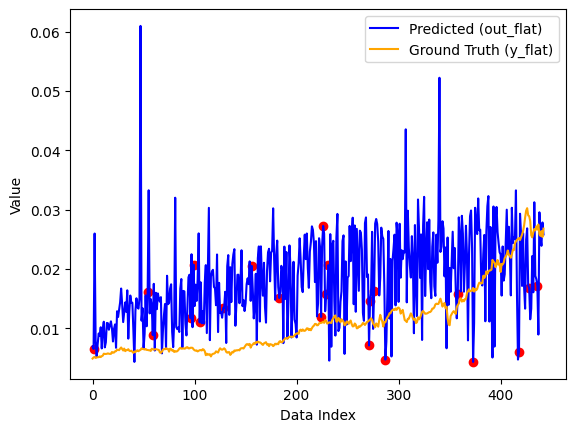

In [492]:
import matplotlib.pyplot as plt
import numpy as np

# Plot the blue line for x (out_flat)
plt.plot(out_flat.numpy(), label='Predicted (out_flat)', color='blue')

# Plot the orange line for y (y_flat)
plt.plot(y_flat.numpy(), label='Ground Truth (y_flat)', color='orange')

# Mark the points corresponding to the top 5 indices
for idx, change in zip(top_indices, top_changes):
    plt.scatter(idx, out_flat[idx], color='red')

# Set labels and legend
plt.xlabel('Data Index')
plt.ylabel('Value')
plt.legend()

# Show the plot
plt.show()

Notes:
- Outliers
- Different regularizations
- Different Hyperparameters (learning rate, hidden layer size, num epochs)
- Different batch size
- Additional features (marketcap..?)